In [ ]:
import numpy as np
import pandas as pd
import os

In [ ]:
!pip install facenet-pytorch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 9.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 37.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 53.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 65.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 12.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 10.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━

In [ ]:
!pip install scikit-image

In [ ]:
!pip install albumentations
!pip show albumentations

Name: albumentations
Version: 1.3.1
Summary: Fast image augmentation library and easy to use wrapper around other libraries
Home-page: https://github.com/albumentations-team/albumentations
Author: Buslaev Alexander, Alexander Parinov, Vladimir Iglovikov, Eugene Khvedchenya, Druzhinin Mikhail
Author-email: 
License: MIT
Location: /usr/local/lib/python3.10/dist-packages
Requires: numpy, opencv-python-headless, PyYAML, qudida, scikit-image, scipy
Required-by: 


In [ ]:
!pip install --upgrade albumentations

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.9/133.9 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.7/14.7 MB 29.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 38.8 MB/s eta 0:00:00
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2
  Attempting uninstall: scikit-image
    Found existing installation: scikit-image 0.19.3
    Uninstalling scikit-image-0.19.3:
      Successfully uninstalled scikit-image-0.19.3
  Attempting uninstall: albumentations
    Found existing installation: albumentations 1.3.1
    Uninstalling albumentations-1.3.1:
      Successfully uninstalled albumentations-1.3.1


In [ ]:
import os
import zipfile
import numpy as np
import pandas as pd
import matplotlib
import seaborn as sns
import torch
import matplotlib.pyplot as plt
import skimage.measure



%matplotlib inline
from google.colab.patches import cv2_imshow
from IPython.display import HTML
from base64 import b64encode
import cv2 as cv
import skimage
import glob
import time
from PIL import Image
from facenet_pytorch import MTCNN, InceptionResnetV1, extract_face
from tqdm import tqdm

import math
import pickle
from functools import partial
from collections import defaultdict

from PIL import Image
from glob import glob

import cv2
import albumentations as A
from tqdm.notebook import tqdm
from albumentations.pytorch import ToTensorV2

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
from torchvision.models.video import mc3_18, r2plus1d_18

from facenet_pytorch import MTCNN

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
DATA_FOLDER = "/content/drive/MyDrive/deepfake-detection-challenge"
TRAIN_SAMPLE_FOLDER = "train_sample_videos"
TEST_FOLDER = "test_videos"


Mounted at /content/drive


In [ ]:
FACE_DETECTION_FOLDER = "/content/drive/MyDrive/harracascades"
print(f"Face detection resources: {os.listdir(FACE_DETECTION_FOLDER)}")

Face detection resources: ['haarcascade_fullbody.xml', 'haarcascade_frontalface_default.xml', 'haarcascade_frontalface_alt_tree.xml', 'haarcascade_frontalface_alt.xml', 'haarcascade_frontalcatface.xml', 'haarcascade_frontalcatface_extended.xml', 'haarcascade_profileface.xml', 'haarcascade_lowerbody.xml', 'haarcascade_lefteye_2splits.xml', 'haarcascade_eye_tree_eyeglasses.xml', 'haarcascade_eye.xml', 'haarcascade_frontalface_alt2.xml', 'haarcascade_licence_plate_rus_16stages.xml', 'haarcascade_smile.xml', 'haarcascade_righteye_2splits.xml', 'haarcascade_upperbody.xml', 'haarcascade_russian_plate_number.xml', 'AUDIO', 'ffmpeg-git-20191209-amd64-static']


In [ ]:
train_list = list(os.listdir(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER)))
ext_dict = []
for file in train_list:
    file_ext = file.split('.')[1]
    if (file_ext not in ext_dict):
        ext_dict.append(file_ext)
print(f"Extensions: {ext_dict}")

Extensions: ['mp4', 'json']


In [ ]:
test_list = list(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER)))
ext_dict = []
for file in test_list:
    file_ext = file.split('.')[1]
    if (file_ext not in ext_dict):
        ext_dict.append(file_ext)
print(f"Extensions: {ext_dict}")

Extensions: ['mp4']


In [ ]:
json_file = [file for file in train_list if  file.endswith('json')][0]
print(f"JSON file: {json_file}")
#reading the json file
def get_meta_from_json(path):
    df = pd.read_json(os.path.join(DATA_FOLDER, path, json_file))
    df = df.T
    return df

meta_train_df = get_meta_from_json(TRAIN_SAMPLE_FOLDER)
meta_train_df.head()

JSON file: metadata.json


,label,split,original
aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,train,None
abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


In [ ]:
def missing_data(data):
    total = data.isnull().sum()
    percent = (data.isnull().sum()/data.isnull().count()*100)
    tt = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
    types = []
    for col in data.columns:
        dtype = str(data[col].dtype)
        types.append(dtype)
    tt['Types'] = types
    return(np.transpose(tt))

In [ ]:
missing_data(meta_train_df)

,label,split,original
Total,0,0,77
Percent,0.0,0.0,19.25
Types,object,object,object


In [ ]:
missing_data(meta_train_df.loc[meta_train_df.label == 'REAL'])

,label,split,original
Total,0,0,77
Percent,0.0,0.0,100.0
Types,object,object,object


In [ ]:
def unique_values(data):
    total = data.count()
    tt = pd.DataFrame(total)
    tt.columns = ['Totals']
    uniques = []
    for col in data.columns:
        unique = data[col].nunique()
        uniques.append(unique)
    tt['Uniques'] = uniques
    return(np.transpose(tt))

In [ ]:
unique_values(meta_train_df)

,label,split,original
Totals,400,400,323
Uniques,2,1,209


In [ ]:
def most_frequent_values(data):
    total = data.count()
    tt = pd.DataFrame(total)
    tt.columns = ['Total']
    items = []
    vals = []
    for col in data.columns:
        itm = data[col].value_counts().index[0]
        val = data[col].value_counts().values[0]
        items.append(itm)
        vals.append(val)
    tt['Most frequent item'] = items
    tt['Frequence'] = vals
    tt['Percent from total'] = np.round(vals / total * 100, 3)
    return(np.transpose(tt))

In [ ]:
most_frequent_values(meta_train_df)

,label,split,original
Total,400,400,323
Most frequent item,FAKE,train,atvmxvwyns.mp4
Frequence,323,400,6
Percent from total,80.75,100.0,1.858


In [ ]:
most_frequent_values(meta_train_df.loc[meta_train_df.label == 'FAKE'])

,label,split,original
Total,323,323,323
Most frequent item,FAKE,train,atvmxvwyns.mp4
Frequence,323,323,6
Percent from total,100.0,100.0,1.858


In [ ]:
def plot_count(feature, title, df, size=1):
    '''
    Plot count of classes / feature
    param: feature - the feature to analyze
    param: title - title to add to the graph
    param: df - dataframe from which we plot feature's classes distribution
    param: size - default 1.
    '''
    f, ax = plt.subplots(1, 1, figsize=(4*size, 4))
    total = float(len(df))
    g = sns.countplot(x=df[feature], order=df[feature].value_counts().index[:20], palette='pink')
    g.set_title("Number and percentage of {}".format(title))
    if size > 2:
        plt.xticks(rotation=90, size=8)
    for p in ax.patches:
        height = p.get_height()
        ax.text(p.get_x() + p.get_width() / 2., height + 3, '{:1.2f}%'.format(100 * height / total), ha="center")

    plt.show()



<ipython-input-22-f13eaccb2824>:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  g = sns.countplot(x=df[feature], order=df[feature].value_counts().index[:20], palette='pink')


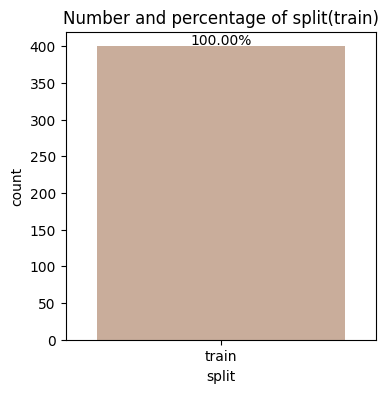

In [ ]:
plot_count('split','split(train)',meta_train_df)

<ipython-input-22-f13eaccb2824>:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  g = sns.countplot(x=df[feature], order=df[feature].value_counts().index[:20], palette='pink')


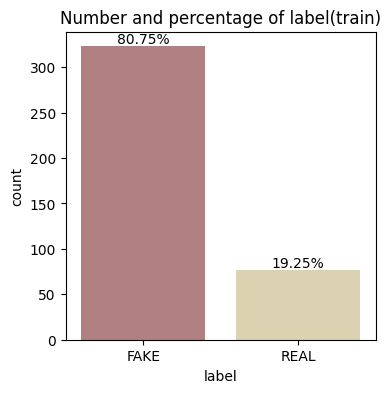

In [ ]:
plot_count('label','label(train)',meta_train_df)

In [ ]:
meta = np.array(list(meta_train_df.index))
storage = np.array([file for file in train_list if  file.endswith('mp4')])
print(f"Metadata: {meta.shape[0]}, Folder: {storage.shape[0]}")
print(f"Files in metadata and not in folder: {np.setdiff1d(meta,storage,assume_unique=False).shape[0]}")
print(f"Files in folder and not in metadata: {np.setdiff1d(storage,meta,assume_unique=False).shape[0]}")

Metadata: 400, Folder: 400
Files in metadata and not in folder: 0
Files in folder and not in metadata: 0


In [ ]:
fake_train_sample_video = list(meta_train_df.loc[meta_train_df.label=='FAKE'].sample(3).index)
fake_train_sample_video

['etmcruaihe.mp4', 'cwqlvzefpg.mp4', 'drtbksnpol.mp4']

In [ ]:
import cv2
def display_image_from_video(video_path):
    '''
    input: video_path - path for video
    process:
    1. perform a video capture from the video
    2. read the image
    3. display the image
    '''
    capture_img = cv.VideoCapture(video_path)
    if not capture_img.isOpened():
        print(f"Error: Could not open video file {video_path}")
        return

    ret, frame = capture_img.read()
    if not ret:
        print(f"Error: Could not read frame from video file {video_path}")
        return

    capture_img.release() # Release the video capture
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
    ax.imshow(frame)
    plt.show() # Display the image

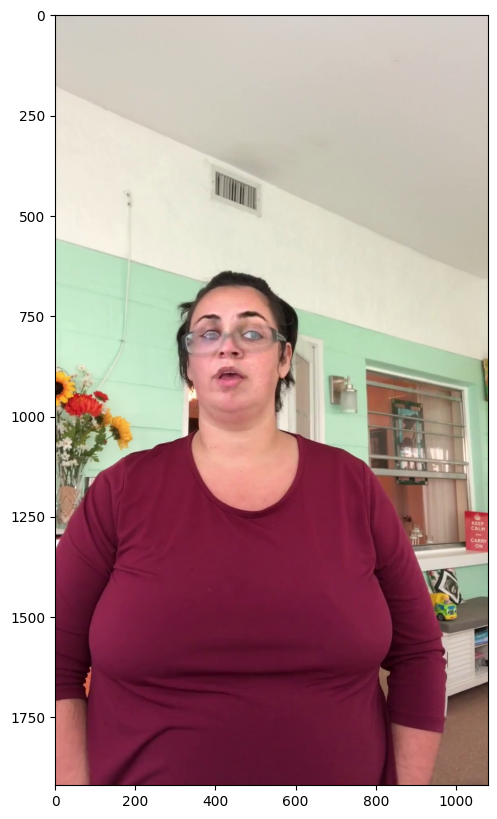

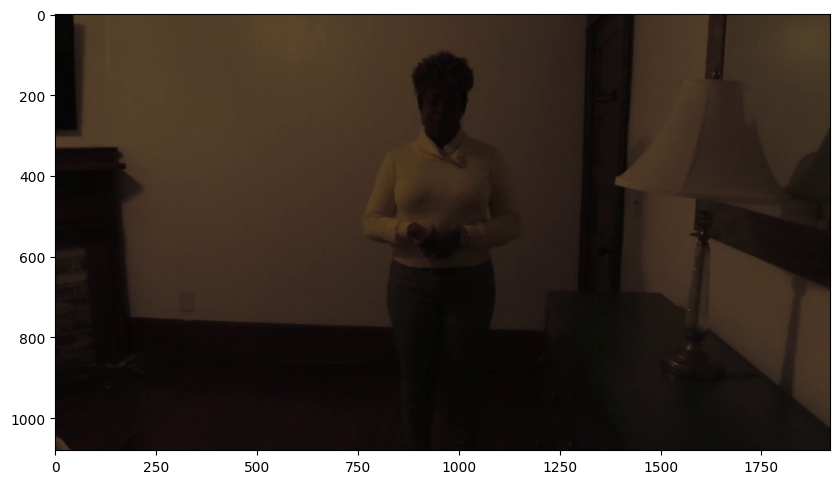

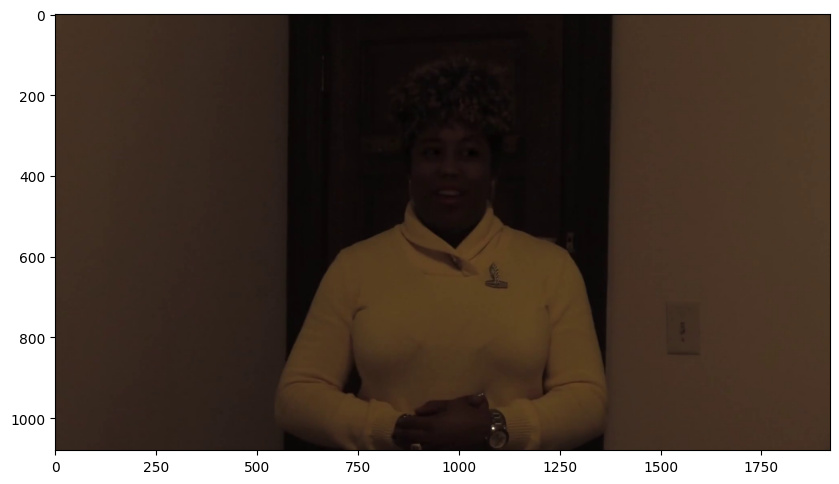

In [ ]:
for video_file in fake_train_sample_video:
  display_image_from_video(os.path.join(DATA_FOLDER,TRAIN_SAMPLE_FOLDER,video_file))

In [ ]:
real_train_sample_video = list(meta_train_df.loc[meta_train_df.label=='REAL'].sample(3).index) #viewing the real videos
real_train_sample_video

['efwfxwwlbw.mp4', 'bulkxhhknf.mp4', 'erlvuvjsjf.mp4']

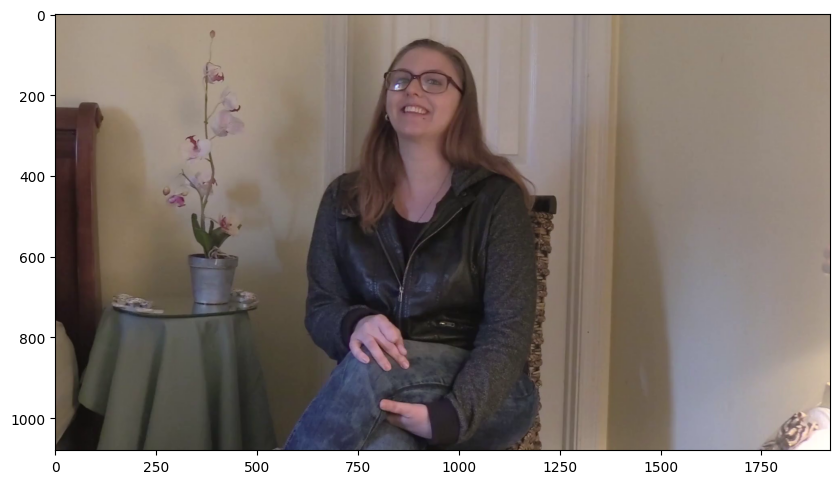

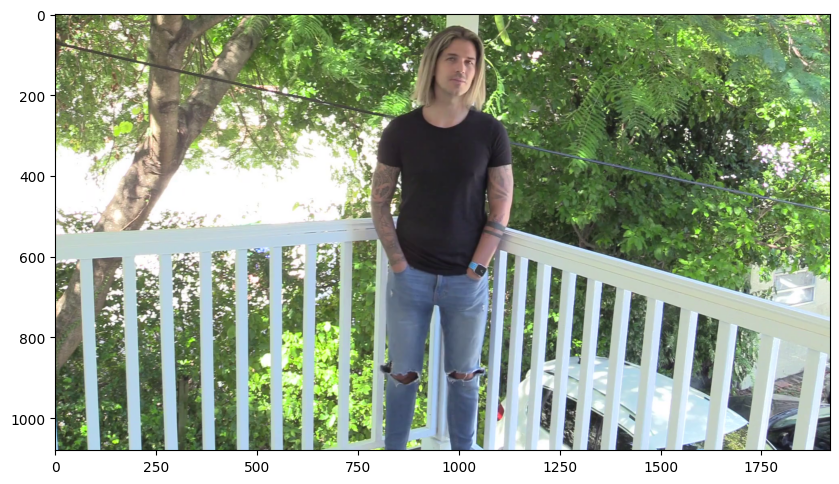

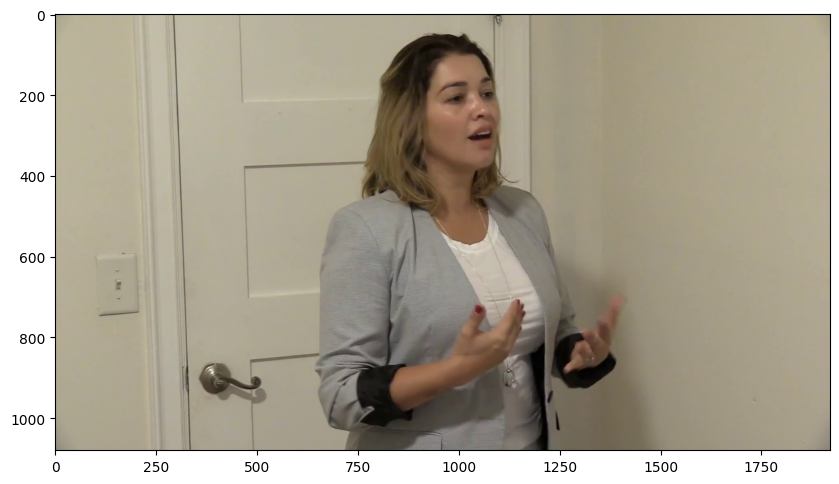

In [ ]:
for video in real_train_sample_video:
  display_image_from_video(os.path.join(DATA_FOLDER,TRAIN_SAMPLE_FOLDER,video))

In [ ]:

def display_image_from_video_list(video_path_list, video_folder=TRAIN_SAMPLE_FOLDER):
    '''
    input: video_path_list - path for video
    process:
    0. for each video in the video path list
        1. perform a video capture from the video
        2. read the image
        3. display the image
    '''
    plt.figure()
    fig, ax = plt.subplots(2,3,figsize=(16,8))
    #we only show images extracted from first 6 videos
    for i, video_file in enumerate(video_path_list[0:6]):
      video_path = os.path.join(DATA_FOLDER, video_folder, video_file)
      capture_img = cv.VideoCapture(video_path)
      ret, frame = capture_img.read()
      frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
      ax[i//3, i%3].imshow(frame)
      ax[i//3, i%3].set_title(f"Video: {video_file}")
      ax[i//3, i%3].axis('on')

<Figure size 640x480 with 0 Axes>

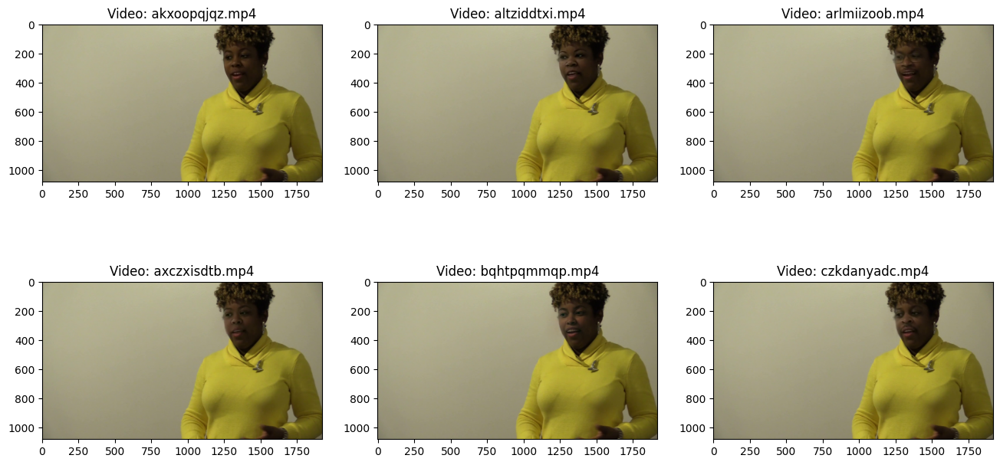

In [ ]:
same_original_fake_train_sample_video = list(meta_train_df.loc[meta_train_df.original=='meawmsgiti.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

In [ ]:
import pandas as pd
import numpy as np
import glob, shutil
import timeit, os, gc
import subprocess as sp
from tqdm import tqdm
from collections import defaultdict
from concurrent.futures import ProcessPoolExecutor, ThreadPoolExecutor
import json
from IPython.display import HTML
from base64 import b64encode
import cv2
%matplotlib inline

In [ ]:
import os
import shutil


In [ ]:
import zipfile

zip_file_path = '/content/drive/MyDrive/deepfake_images.zip'
extract_folder = '/content/deepfake_images'

if not os.path.exists(extract_folder):
    os.makedirs(extract_folder)


with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_folder)

print("Extraction completed successfully.")

Extraction completed successfully.


In [ ]:
import os
import shutil

# Path to the deepfake_images folder
folder_path = '/content/deepfake_images'

# Create the images folder if it doesn't exist
images_folder = os.path.join(folder_path, 'images')
os.makedirs(images_folder, exist_ok=True)

# Iterate through all the folders from DeepFake00 to DeepFake49
for folder_name in os.listdir(folder_path):
    folder_path_full = os.path.join(folder_path, folder_name)
    if os.path.isdir(folder_path_full):
        # Iterate through all the files (images) inside the subfolder with the same name
        subfolder_path = os.path.join(folder_path_full, folder_name)
        if os.path.isdir(subfolder_path):
            for filename in os.listdir(subfolder_path):
                file_path = os.path.join(subfolder_path, filename)
                if os.path.isfile(file_path):
                    # Copy the file to the images folder
                    shutil.copy(file_path, images_folder)

print("All images copied to the images folder.")


All images copied to the images folder.


In [ ]:
items = os.listdir('/content/deepfake_images/images')
len(items)

112256

In [ ]:
import os
import shutil

# Path to the images folder inside deepfake_images
images_folder_path = '/content/deepfake_images/images'

# Path to the destination folder in the content directory
destination_folder_path = '/content'

# Move the images folder to the content directory
shutil.move(images_folder_path, destination_folder_path)

print("Images folder moved to content directory.")


Images folder moved to content directory.


In [ ]:
import shutil

# Path to the deepfake_images folder
deepfake_images_folder_path = '/content/deepfake_images'

# Delete the deepfake_images folder
shutil.rmtree(deepfake_images_folder_path)

print("deepfake_images folder deleted.")


deepfake_images folder deleted.


In [ ]:
HOME = "./"
FFMPEG = "/content/drive/MyDrive/harracascades/ffmpeg-git-20191209-amd64-static"
FFMPEG_PATH = FFMPEG
DATA_FOLDER = "/content/drive/MyDrive/deepfake-detection-challenge"
TMP_FOLDER = HOME
DATA_FOLDER_TRAIN = DATA_FOLDER
VIDEOS_FOLDER_TRAIN = DATA_FOLDER_TRAIN + "/train_sample_videos"
IMAGES_FOLDER_TRAIN = "/content/images"
AUDIOS_FOLDER_TRAIN = "/content/drive/MyDrive/harracascades/AUDIO"
EXTRACT_META = True # False
EXTRACT_CONTENT = True # False
EXTRACT_FACES = True # False
FRAME_RATE = 0.5 # Frame per
print(FFMPEG)

/content/drive/MyDrive/harracascades/ffmpeg-git-20191209-amd64-static


In [ ]:
os.listdir(AUDIOS_FOLDER_TRAIN)
len(os.listdir(IMAGES_FOLDER_TRAIN))

112256

In [ ]:
def run_command(*popenargs, **kwargs):
    closeNULL = 0
    try:
        from subprocess import DEVNULL
        closeNULL = 0
    except ImportError:
        import os
        DEVNULL = open(os.devnull, 'wb')
        closeNULL = 1

    process = sp.Popen(stdout=sp.PIPE, stderr=DEVNULL, *popenargs, **kwargs)
    output, unused_err = process.communicate()
    retcode = process.poll()

    if closeNULL:
        DEVNULL.close()

    if retcode:
        cmd = kwargs.get("args")
        if cmd is None:
            cmd = popenargs[0]
        error = sp.CalledProcessError(retcode, cmd)
        error.output = output
        raise error
    return output

def ffprobe(filename, options = ["-show_error", "-show_format", "-show_streams", "-show_programs", "-show_chapters", "-show_private_data"]):
    ret = {}
    command = [FFMPEG_PATH + "/ffprobe", "-v", "error", *options, "-print_format", "json", filename]
    ret = run_command(command)
    if ret:
        ret = json.loads(ret)
    return ret

# ffmpeg -i input.mov -r 0.25 output_%04d.png
def ffextract_frames(filename, output_folder, rate = 0.25):
    command = [FFMPEG_PATH + "/ffmpeg", "-i", filename, "-r", str(rate), "-y", output_folder + "/output_%04d.png"]
    ret = run_command(command)
    return ret

# ffmpeg -i input-video.mp4 output-audio.mp3
def ffextract_audio(filename, output_path):
    command = [FFMPEG_PATH + "/ffmpeg", "-i", filename, "-vn", "-ac", "1", "-acodec", "copy", "-y", output_path]
    ret = run_command(command)
    return ret

In [ ]:
!chmod +x '/content/drive/MyDrive/harracascades/ffmpeg-git-20191209-amd64-static/ffmpeg'


In [ ]:
!chmod +x '/content/drive/MyDrive/harracascades/ffmpeg-git-20191209-amd64-static/ffprobe'

In [ ]:
if EXTRACT_META == True:
    results = []
    subfolder = VIDEOS_FOLDER_TRAIN
    filepaths = glob.glob(subfolder + "/*.mp4")
    for filepath in tqdm(filepaths):
        js = ffprobe(filepath)
#        print(js)
        if js:
            results.append(
                (js.get("format", {}).get("filename")[len(subfolder) + 1:],
                js.get("format", {}).get("format_long_name"),
                # Video
                js.get("streams", [{}, {}])[0].get("codec_name"),
                js.get("streams", [{}, {}])[0].get("height"),
                js.get("streams", [{}, {}])[0].get("width"),
                js.get("streams", [{}, {}])[0].get("nb_frames"),
                js.get("streams", [{}, {}])[0].get("bit_rate"),
                js.get("streams", [{}, {}])[0].get("duration"),
                js.get("streams", [{}, {}])[0].get("start_time"),
                js.get("streams", [{}, {}])[0].get("avg_frame_rate"),
                 # Audio
                js.get("streams", [{}, {}])[1].get("codec_name"),
                js.get("streams", [{}, {}])[1].get("channels"),
                js.get("streams", [{}, {}])[1].get("sample_rate"),
                js.get("streams", [{}, {}])[1].get("nb_frames"),
                js.get("streams", [{}, {}])[1].get("bit_rate"),
                js.get("streams", [{}, {}])[1].get("duration"),
                js.get("streams", [{}, {}])[1].get("start_time")),
            )

    meta_pd = pd.DataFrame(results, columns=["filename", "format", "video_codec_name", "video_height", "video_width",
                                            "video_nb_frames", "video_bit_rate", "video_duration", "video_start_time","video_fps",
                                            "audio_codec_name", "audio_channels", "audio_sample_rate", "audio_nb_frames",
                                            "audio_bit_rate", "audio_duration", "audio_start_time"])
    meta_pd["video_fps"] = meta_pd["video_fps"].apply(lambda x: float(x.split("/")[0])/float(x.split("/")[1]) if len(x.split("/")) == 2 else None)
    meta_pd["video_duration"] = meta_pd["video_duration"].astype(np.float32)
    meta_pd["video_bit_rate"] = meta_pd["video_bit_rate"].astype(np.float32)
    meta_pd["video_start_time"] = meta_pd["video_start_time"].astype(np.float32)
    meta_pd["video_nb_frames"] = meta_pd["video_nb_frames"].astype(np.float32)
    meta_pd["video_bit_rate"] = meta_pd["video_bit_rate"].astype(np.float32)
    meta_pd["audio_sample_rate"] = meta_pd["audio_sample_rate"].astype(np.float32)
    meta_pd["audio_nb_frames"] = meta_pd["audio_nb_frames"].astype(np.float32)
    meta_pd["audio_bit_rate"] = meta_pd["audio_bit_rate"].astype(np.float32)
    meta_pd["audio_duration"] = meta_pd["audio_duration"].astype(np.float32)
    meta_pd["audio_start_time"] = meta_pd["audio_start_time"].astype(np.float32)
    meta_pd.to_pickle(HOME + "videos_meta.pkl")
else:
    meta_pd = pd.read_pickle(HOME + "videos_meta.pkl")
meta_pd.head()

100%|██████████| 400/400 [00:44<00:00,  9.06it/s]


,filename,format,video_codec_name,video_height,video_width,video_nb_frames,video_bit_rate,video_duration,video_start_time,video_fps,audio_codec_name,audio_channels,audio_sample_rate,audio_nb_frames,audio_bit_rate,audio_duration,audio_start_time
0,aagfhgtpmv.mp4,QuickTime / MOV,h264,1080,1920,300.0,8650134.0,10.01001,0.0,29.97,aac,1,48000.0,470.0,69279.0,10.0,0.0
1,aapnvogymq.mp4,QuickTime / MOV,h264,1080,1920,300.0,3494923.0,10.01001,0.0,29.97,aac,1,48000.0,470.0,69348.0,10.0,0.0
2,abqwwspghj.mp4,QuickTime / MOV,h264,1080,1920,300.0,2728571.0,10.01001,0.0,29.97,aac,1,48000.0,470.0,69320.0,10.0,0.0
3,abofeumbvv.mp4,QuickTime / MOV,h264,1080,1920,300.0,2156072.0,10.01001,0.0,29.97,aac,1,48000.0,470.0,69289.0,10.0,0.0
4,acxnxvbsxk.mp4,QuickTime / MOV,h264,1080,1920,300.0,2966969.0,10.01001,0.0,29.97,aac,1,48000.0,470.0,69349.0,10.0,0.0


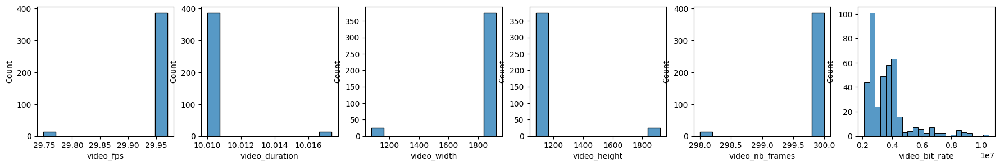

In [ ]:
fig, ax = plt.subplots(1,6, figsize=(22, 3))
d = sns.histplot(meta_pd["video_fps"], ax=ax[0])
d = sns.histplot(meta_pd["video_duration"], ax=ax[1])
d = sns.histplot(meta_pd["video_width"], ax=ax[2])
d = sns.histplot(meta_pd["video_height"], ax=ax[3])
d = sns.histplot(meta_pd["video_nb_frames"], ax=ax[4])
d = sns.histplot(meta_pd["video_bit_rate"], ax=ax[5])

<ipython-input-47-ee6a5630d979>:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  d = sns.distplot(meta_pd["video_fps"], ax=ax[0])
<ipython-input-47-ee6a5630d979>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  d = sns.distplot(meta_pd["video_duration"], ax=ax[1])
<ipython-input-47-ee6a5630d979>:4: UserWarning: 

`distpl

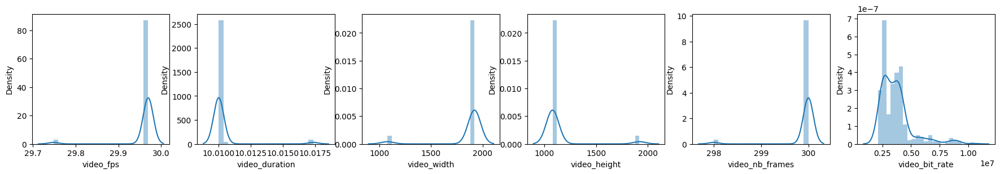

In [ ]:
fig, ax = plt.subplots(1,6, figsize=(22, 3))
d = sns.distplot(meta_pd["video_fps"], ax=ax[0])
d = sns.distplot(meta_pd["video_duration"], ax=ax[1])
d = sns.distplot(meta_pd["video_width"], ax=ax[2])
d = sns.distplot(meta_pd["video_height"], ax=ax[3])
d = sns.distplot(meta_pd["video_nb_frames"], ax=ax[4])
d = sns.distplot(meta_pd["video_bit_rate"], ax=ax[5])

In [ ]:
train_pd = pd.read_json(VIDEOS_FOLDER_TRAIN + "/metadata.json").T.reset_index().rename(columns={"index": "filename"})
train_pd.head()

,filename,label,split,original
0,aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
1,aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
2,abarnvbtwb.mp4,REAL,train,None
3,abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
4,abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


In [ ]:
train_pd = pd.read_json(VIDEOS_FOLDER_TRAIN + "/metadata.json").T.reset_index().rename(columns={"index": "filename"})
train_pd.head()

,filename,label,split,original
0,aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
1,aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
2,abarnvbtwb.mp4,REAL,train,None
3,abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
4,abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


In [ ]:
train_pd = pd.merge(train_pd, meta_pd[["filename", "video_height", "video_width", "video_nb_frames", "video_bit_rate", "audio_nb_frames"]], on="filename", how="left")
train_pd["count"] = train_pd.groupby(["original"])["original"].transform('count')
# train_pd.to_pickle(HOME + "train_meta.pkl")
train_pd.head()

,filename,label,split,original,video_height,video_width,video_nb_frames,video_bit_rate,audio_nb_frames,count
0,aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4,1080,1920,300.0,8650134.0,470.0,1.0
1,aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4,1080,1920,300.0,3494923.0,470.0,2.0
2,abarnvbtwb.mp4,REAL,train,None,1080,1920,300.0,3942492.0,470.0,NaN
3,abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4,1080,1920,300.0,2156072.0,470.0,6.0
4,abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4,1080,1920,300.0,2728571.0,470.0,3.0


In [ ]:
AUDIO_FORMAT = "aac" # "wav"
videos_folder = VIDEOS_FOLDER_TRAIN
images_folder_path = IMAGES_FOLDER_TRAIN
audios_folder_path = AUDIOS_FOLDER_TRAIN
if EXTRACT_CONTENT == True:
    # 1h20min for chunk#0 (11GB)
    # Extract some images + audio track
    for idx, row in tqdm(train_pd.iterrows(), total=meta_pd.shape[0]):
        try:
            video_path = videos_folder + "/" + row["filename"]
            images_path = images_folder_path + "/" + row["filename"][:-4]
            audio_path = audios_folder_path + "/" + row["filename"][:-4]
            # Extract images
            if not os.path.exists(images_path): os.makedirs(images_path)
            ret = ffextract_frames(video_path, images_path, rate = FRAME_RATE)
            # Extract audio
            if not os.path.exists(audio_path): os.makedirs(audio_path)
            # ret = ffextract_audio(video_path, audio_path + "/audio." + AUDIO_FORMAT)
        except:
            print("Cannot extract frames/audio for:" + row["filename"])

  2%|▏         | 7/400 [00:39<29:53,  4.56s/it]

Cannot extract frames/audio for:acqfdwsrhi.mp4


  7%|▋         | 27/400 [02:51<34:50,  5.61s/it]

Cannot extract frames/audio for:ajqslcypsw.mp4


 97%|█████████▋| 389/400 [37:56<00:51,  4.69s/it]

Cannot extract frames/audio for:esckbnkkvb.mp4


100%|██████████| 400/400 [38:56<00:00,  5.84s/it]


In [ ]:
save_path = '/content/drive/My Drive/train_pd.pkl'

# Save the train_pd dataframe
with open(save_path, 'wb') as f:
    pickle.dump(train_pd, f)

print(f"train_pd saved to {save_path}")

train_pd saved to /content/drive/My Drive/train_pd.pkl


In [ ]:
train_pd.tail()

,filename,label,split,original,video_height,video_width,video_nb_frames,video_bit_rate,audio_nb_frames,count
395,etejaapnxh.mp4,FAKE,train,wtreibcmgm.mp4,1080,1920,300.0,4129098.0,470.0,2.0
396,etmcruaihe.mp4,FAKE,train,afoovlsmtx.mp4,1920,1080,300.0,2670789.0,432.0,1.0
397,etohcvnzbj.mp4,FAKE,train,bdnaqemxmr.mp4,1080,1920,300.0,6816451.0,470.0,1.0
398,eudeqjhdfd.mp4,REAL,train,None,1080,1920,300.0,5651024.0,470.0,NaN
399,eukvucdetx.mp4,FAKE,train,gjypopglvi.mp4,1080,1920,300.0,2440299.0,470.0,4.0


In [56]:
idx = 27 # 27 # 21 # 19 # 12 # 6
fake = train_pd["filename"][idx]
real = train_pd["original"][idx]
vid_width = train_pd["video_width"][idx]
vid_real = open(VIDEOS_FOLDER_TRAIN + "/" + real, 'rb').read()
data_url_real = "data:video/mp4;base64," + b64encode(vid_real).decode()
vid_fake = open(VIDEOS_FOLDER_TRAIN + "/" + fake, 'rb').read()
data_url_fake = "data:video/mp4;base64," + b64encode(vid_fake).decode()
HTML("""
<div style='width: 100%%; display: table;'>
    <div style='display: table-row'>
        <div style='width: %dpx; display: table-cell;'><b>Real</b>: %s<br/><video width=%d controls><source src="%s" type="video/mp4"></video></div>
        <div style='display: table-cell;'><b>Fake</b>: %s<br/><video width=%d controls><source src="%s" type="video/mp4"></video></div>
    </div>
</div>
""" % ( int(vid_width/3.2) + 10,
       real, int(vid_width/3.2), data_url_real,
       fake, int(vid_width/3.2), data_url_fake))

In [57]:
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")

def detect_face_cv2(img):
    # Move to grayscale
    gray_img = cv2.cvtColor(img.copy(), cv2.COLOR_RGB2GRAY)
    face_locations = []
    face_rects = face_cascade.detectMultiScale(gray_img, scaleFactor=1.3, minNeighbors=5)
    for (x,y,w,h) in face_rects:
        face_location = (x,y,w,h)
        face_locations.append((face_location, 1.0))
    return face_locations

In [58]:
!pip install mtcnn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 7.6 MB/s eta 0:00:00


In [59]:
from mtcnn import MTCNN
detector = MTCNN()

def detect_face_mtcnn(img):
    face_locations = []
    items = detector.detect_faces(img)
    for face in items:
        face_location = tuple(face.get('box'))
        face_confidence = float(face.get('confidence'))
        face_locations.append((face_location, face_confidence))
    return face_locations

In [60]:
def extract_faces(files, source, detector=detect_face_cv2):
    results = []
    # for idx, file in tqdm(enumerate(files), total=len(files)):
    for idx, file in enumerate(files):
        try:
            img = cv2.cvtColor(cv2.imread(file, cv2.IMREAD_UNCHANGED), cv2.COLOR_BGR2RGB)
            face_locations = detector(img)
            results.append((source, file[file.find("output_"):], face_locations, len(face_locations)))
        except:
            print("Cannot extract faces for image: %s" % file)
    return results

In [61]:
file = fake
dump_folder = images_folder_path + "/" + file[:-4]
files = glob.glob(dump_folder + "/*")
DETECTORS = {
    "cv2": detect_face_cv2,
    "mtcnn": detect_face_mtcnn
}
faces_pd = None
for key, value in DETECTORS.items():
    tmp_pd = pd.DataFrame(extract_faces(files, file, detector=value), columns=["filename", "image", "boxes_" + key , "faces_" + key])
    if faces_pd is None:
        faces_pd = tmp_pd
    else:
        faces_pd = pd.merge(faces_pd, tmp_pd, on=["filename", "image"], how="left")
faces_pd.head(12)

1/1 [==============================] - 0s 188ms/step


,filename,image,boxes_cv2,faces_cv2,boxes_mtcnn,faces_mtcnn
0,ajwpjhrbcv.mp4,output_0002.png,"[((802, 48, 149, 149), 1.0)]",1,"[((822, 46, 117, 150), 0.9999814629554749)]",1
1,ajwpjhrbcv.mp4,output_0004.png,"[((803, 49, 149, 149), 1.0)]",1,"[((824, 46, 119, 156), 0.9999949336051941)]",1
2,ajwpjhrbcv.mp4,output_0006.png,"[((798, 46, 158, 158), 1.0)]",1,"[((821, 42, 125, 163), 0.9999986290931702)]",1
3,ajwpjhrbcv.mp4,output_0005.png,"[((802, 46, 150, 150), 1.0)]",1,"[((822, 42, 122, 158), 0.9999838471412659)]",1
4,ajwpjhrbcv.mp4,output_0003.png,"[((802, 46, 153, 153), 1.0)]",1,"[((828, 46, 115, 150), 0.9999932646751404)]",1
5,ajwpjhrbcv.mp4,output_0007.png,"[((805, 47, 151, 151), 1.0)]",1,"[((829, 44, 120, 154), 0.9999992251396179)]",1
6,ajwpjhrbcv.mp4,output_0001.png,"[((801, 47, 152, 152), 1.0)]",1,"[((822, 42, 121, 159), 0.9999819397926331)]",1


In [62]:
def plot_faces_boxes(df, max_cols = 2, max_rows = 6, fsize=(24, 5), max_items=12):
    idx = 0
    for item_idx, item in df.iterrows():
        img = cv2.cvtColor(cv2.imread(IMAGES_FOLDER_TRAIN + "/" + item["filename"][:-4] +"/" + item["image"], cv2.IMREAD_UNCHANGED), cv2.COLOR_BGR2RGB)
        face_img = img #.copy()
        # grid subplots
        row = idx // max_cols
        col = idx % max_cols
        if col == 0: fig = plt.figure(figsize=fsize)
        ax = fig.add_subplot(1, max_cols, col + 1)
        ax.axis("off")
        # display image with boxes
        cols = [c for c in df.columns if "boxes" in c]
        for i, c in enumerate(cols, 0):
            face_locations = item[c]
            face_confidence = item[c]
            if len(face_locations) > 0:
                for face_location in face_locations:
                    ((x,y,w,h), confidence) = face_location
                    # face_img = face_img[y:y+h, x:x+w]
                    cv2.rectangle(face_img, (x, y), (x+w, y+h), (255,i*255,0), 8)
                    cv2.putText(face_img, '%.1f' % (confidence*100.0), (x+w, y+h), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (255,i*255,0), 9, cv2.LINE_AA)
                ax.imshow(face_img)
            else:
                ax.imshow(img)
            ax.set_title("%s %s / %s - Faces: %d %s %s" % (item["label"] if "label" in df.columns else "",
                                                           item["filename"], item["image"],
                                                           item["faces_mtcnn"] if "faces_mtcnn" in df.columns else len(face_locations),
                                                           item["faces_mtcnn_median"] if "faces_mtcnn_median" in df.columns else "",
                                                           item["faces"] if "faces" in df.columns else ""))
        if (col == max_cols -1): plt.show()
        idx = idx + 1
        if (max_items > 0 and idx >=max_items): break

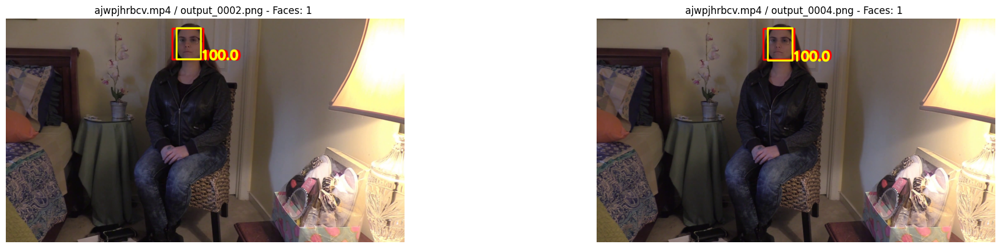

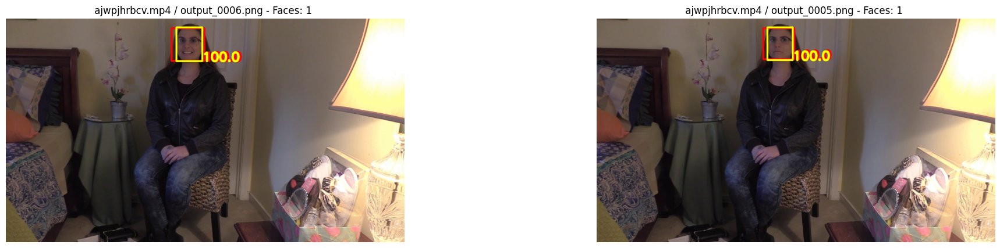

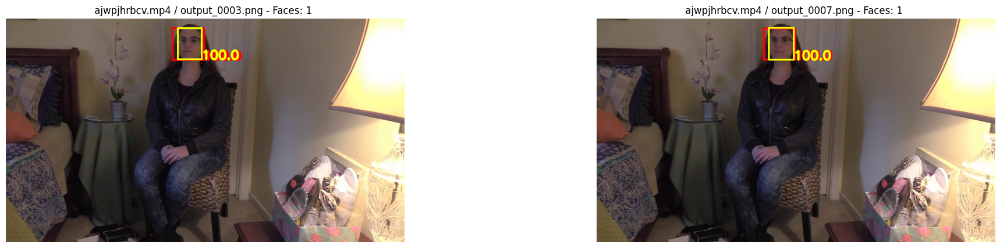

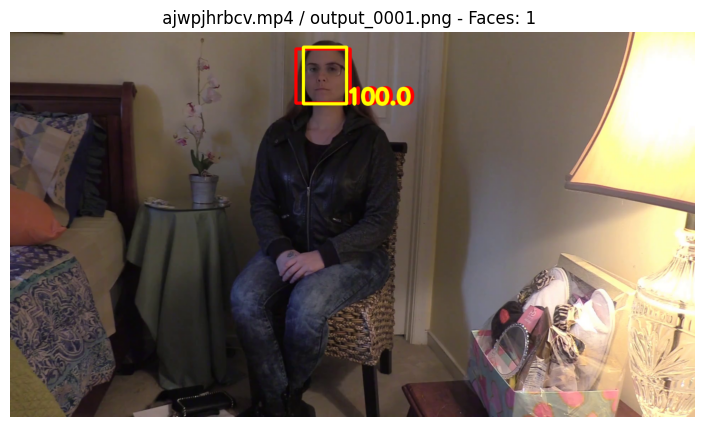

In [63]:
plot_faces_boxes(faces_pd)

In [64]:
def run_detector_on_video(videos_filename, verbose=False):
    if verbose == True:
        print("Starting with batch of %d videos" % len(videos_filename))
    tmp_faces_pd = None
    for file in videos_filename:
        # Find out dump folder with images
        dump_folder = images_folder_path + "/" + file[:-4]
        # List files
        files = glob.glob(dump_folder + "/*")
        DETECTORS = {
            "mtcnn": detect_face_mtcnn
        }
        for key, value in DETECTORS.items():
            tmp_pd = pd.DataFrame(extract_faces(files, file, detector=value), columns=["filename", "image", "boxes_" + key , "faces_" + key])
            if tmp_faces_pd is None:
                tmp_faces_pd = tmp_pd
            else:
                tmp_faces_pd = pd.concat([tmp_faces_pd, tmp_pd], axis=0)
    return tmp_faces_pd

In [66]:
import multiprocessing
from concurrent.futures import ThreadPoolExecutor
from tqdm import tqdm
import numpy as np
import pandas as pd

cpus = multiprocessing.cpu_count()

if EXTRACT_FACES == True:
    resultfutures = []
    results = []
    tasks = np.array_split(train_pd["filename"].unique(), 20)
    print("Tasks: %d" % len(tasks))
    with ThreadPoolExecutor(max_workers=cpus) as executor:
        resultfutures = tqdm(executor.map(run_detector_on_video, tasks), total=len(tasks))
    results = [x for x in resultfutures]
    executor.shutdown()

    # Gather results
    all_faces_pd = None
    for result in results:
        if all_faces_pd is None:
            all_faces_pd = result
        else:
            all_faces_pd = pd.concat([all_faces_pd, result], axis=0)
    all_faces_pd = all_faces_pd.reset_index(drop=True)

    # Save to Google Drive
    save_path = '/content/drive/My Drive/faces.pkl'
    all_faces_pd.to_pickle(save_path)
    print(f"faces.pkl saved to {save_path}")

else:
    # Load from Google Drive
    load_path = '/content/drive/My Drive/faces.pkl'
    all_faces_pd = pd.read_pickle(load_path)
    print(f"faces.pkl loaded from {load_path}")

print(all_faces_pd.shape)


Tasks: 20


  0%|          | 0/20 [01:13<?, ?it/s]


Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 90ms/step


100%|██████████| 20/20 [5:05:52<00:00, 917.63s/it]    

faces.pkl saved to /content/drive/My Drive/faces.pkl
(2790, 4)


In [67]:
all_faces_pd["faces_mtcnn_avg"] = all_faces_pd.groupby("filename")["faces_mtcnn"].transform(np.nanmean)
all_faces_pd["faces_mtcnn_median"] = all_faces_pd.groupby("filename")["faces_mtcnn"].transform(np.nanmedian)
all_faces_pd.head()

,filename,image,boxes_mtcnn,faces_mtcnn,faces_mtcnn_avg,faces_mtcnn_median
0,aagfhgtpmv.mp4,output_0002.png,"[((338, 167, 220, 292), 0.9999215006828308)]",1,1.285714,1.0
1,aagfhgtpmv.mp4,output_0004.png,"[((1117, 162, 221, 309), 0.9999964833259583)]",1,1.285714,1.0
2,aagfhgtpmv.mp4,output_0006.png,"[((996, 121, 203, 272), 0.9999921917915344), (...",2,1.285714,1.0
3,aagfhgtpmv.mp4,output_0005.png,"[((1056, 129, 203, 276), 0.9999472498893738), ...",2,1.285714,1.0
4,aagfhgtpmv.mp4,output_0003.png,"[((511, 180, 211, 283), 0.9999808073043823)]",1,1.285714,1.0


<ipython-input-68-ff7101debad5>:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  d = sns.distplot(all_faces_pd["faces_mtcnn_avg"], kde=True, ax=ax[0])
<ipython-input-68-ff7101debad5>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  d = sns.distplot(all_faces_pd["faces_mtcnn_median"], kde=False, ax=ax[1])


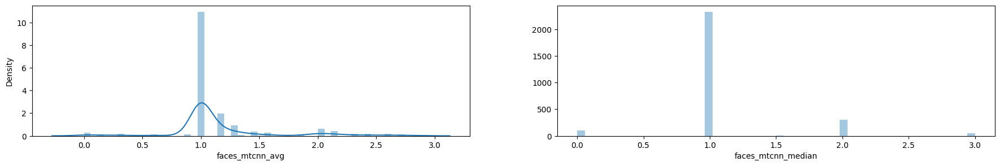

In [68]:
fig, ax = plt.subplots(1, 2, figsize=(22, 3))
d = sns.distplot(all_faces_pd["faces_mtcnn_avg"], kde=True, ax=ax[0])
d = sns.distplot(all_faces_pd["faces_mtcnn_median"], kde=False, ax=ax[1])

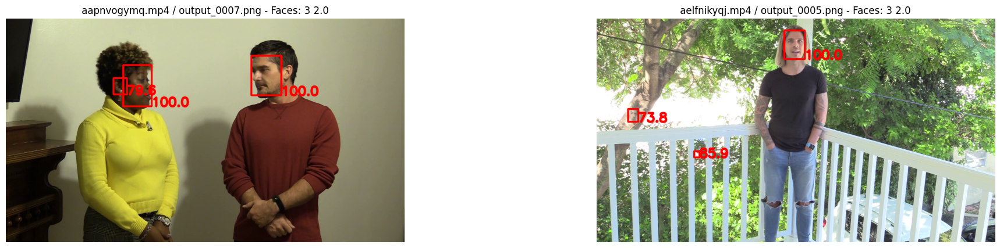

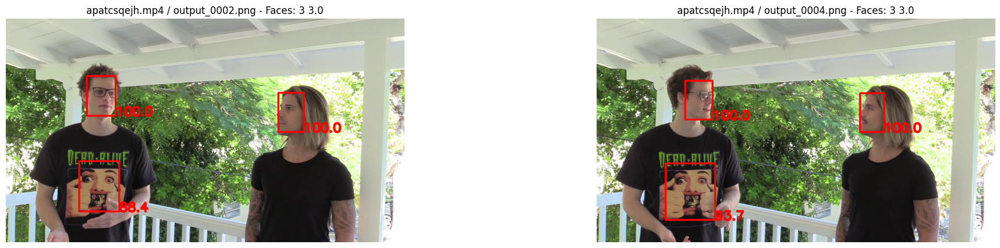

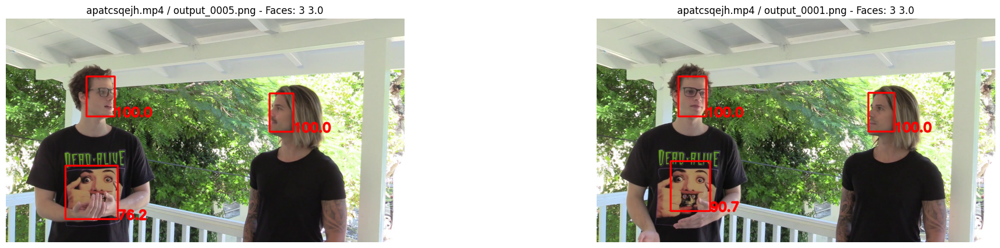

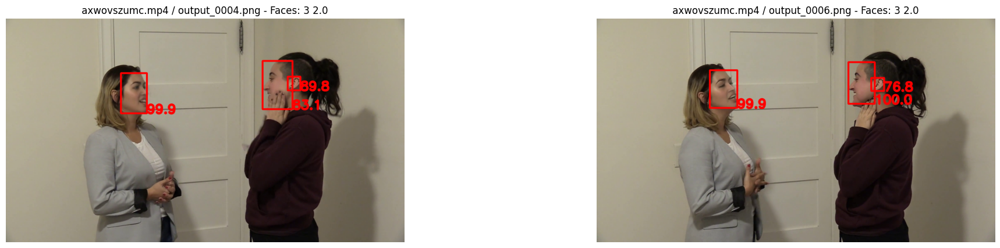

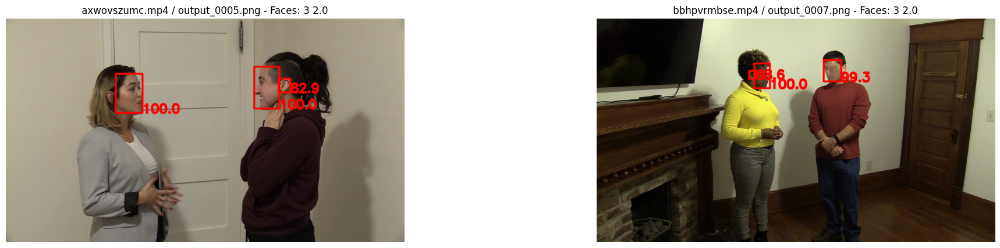

...

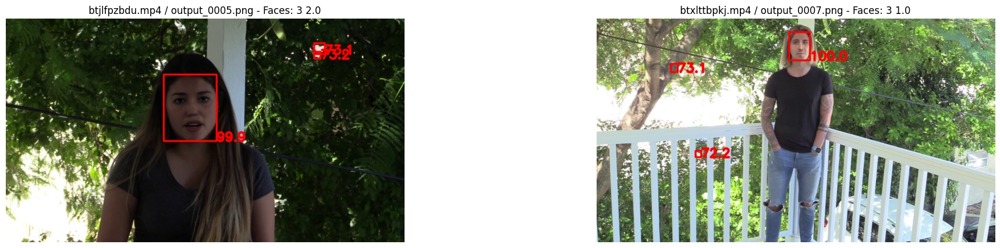

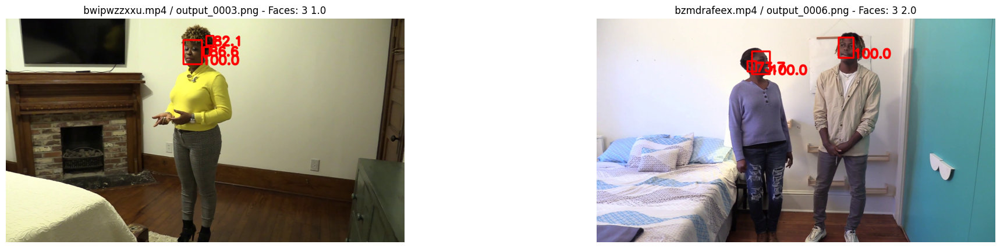

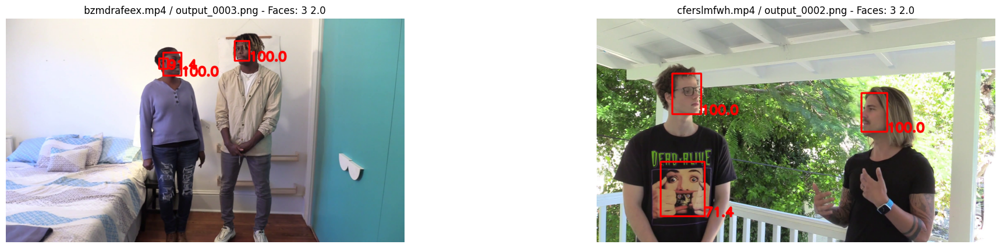

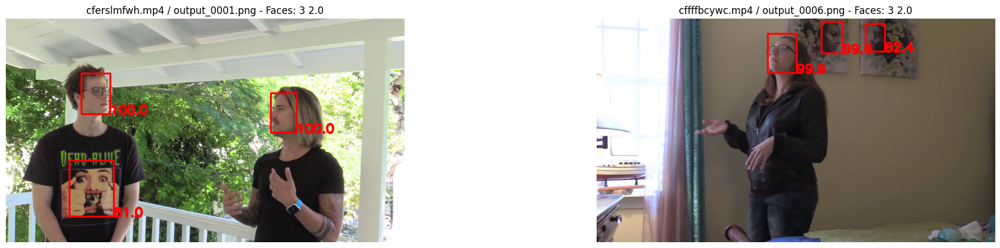

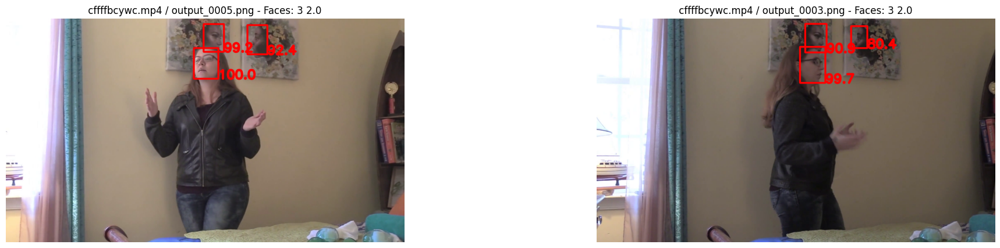

In [69]:
plot_faces_boxes(all_faces_pd[all_faces_pd["faces_mtcnn"] == 3], max_items=24)

In [70]:
clean_faces_pd = pd.merge(all_faces_pd, train_pd, on="filename", how="left")
clean_faces_pd.head()

,filename,image,boxes_mtcnn,faces_mtcnn,faces_mtcnn_avg,faces_mtcnn_median,label,split,original,video_height,video_width,video_nb_frames,video_bit_rate,audio_nb_frames,count
0,aagfhgtpmv.mp4,output_0002.png,"[((338, 167, 220, 292), 0.9999215006828308)]",1,1.285714,1.0,FAKE,train,vudstovrck.mp4,1080,1920,300.0,8650134.0,470.0,1.0
1,aagfhgtpmv.mp4,output_0004.png,"[((1117, 162, 221, 309), 0.9999964833259583)]",1,1.285714,1.0,FAKE,train,vudstovrck.mp4,1080,1920,300.0,8650134.0,470.0,1.0
2,aagfhgtpmv.mp4,output_0006.png,"[((996, 121, 203, 272), 0.9999921917915344), (...",2,1.285714,1.0,FAKE,train,vudstovrck.mp4,1080,1920,300.0,8650134.0,470.0,1.0
3,aagfhgtpmv.mp4,output_0005.png,"[((1056, 129, 203, 276), 0.9999472498893738), ...",2,1.285714,1.0,FAKE,train,vudstovrck.mp4,1080,1920,300.0,8650134.0,470.0,1.0
4,aagfhgtpmv.mp4,output_0003.png,"[((511, 180, 211, 283), 0.9999808073043823)]",1,1.285714,1.0,FAKE,train,vudstovrck.mp4,1080,1920,300.0,8650134.0,470.0,1.0


In [71]:
def faces_max_item(boxes, idx1, idx2):
    ret = 0
    if len(boxes) > 0:
        ret = max(boxes, key=lambda item: item[idx1][idx2])[idx1][idx2]
    return ret

def faces_max_confidence(boxes):
    ret = 0
    if len(boxes) > 0:
        ret = max(boxes, key=lambda item: item[1])[1]
    return ret

def faces_min_confidence(boxes):
    ret = 0
    if len(boxes) > 0:
        ret = min(boxes, key=lambda item: item[1])[1]
    return ret

clean_faces_pd["faces_max_width"] = clean_faces_pd["boxes_mtcnn"].apply(lambda x: faces_max_item(x, 0, 2))
clean_faces_pd["faces_max_height"] = clean_faces_pd["boxes_mtcnn"].apply(lambda x: faces_max_item(x, 0, 3))
clean_faces_pd["faces_max_conf"] = clean_faces_pd["boxes_mtcnn"].apply(lambda x: faces_max_confidence(x))
clean_faces_pd["faces_min_conf"] = clean_faces_pd["boxes_mtcnn"].apply(lambda x: faces_min_confidence(x))

Faces stats:
       faces_max_width  faces_max_height  faces_min_conf  faces_max_conf
count      2790.000000       2790.000000     2790.000000     2790.000000
mean        152.345161        198.754122        0.943979        0.960764
std          60.304292         77.852766        0.191924        0.186731
min           0.000000          0.000000        0.000000        0.000000
1%            0.000000          0.000000        0.000000        0.000000
5%           75.000000        101.000000        0.729861        0.914511
10%          83.000000        109.000000        0.834079        0.998278
25%         100.000000        132.000000        0.999346        0.999777
50%         170.000000        218.000000        0.999953        0.999973
75%         198.000000        259.000000        0.999994        0.999996
90%         228.000000        298.000000        0.999999        0.999999
95%         240.000000        311.000000        1.000000        1.000000
99%         258.000000        331.0000

<ipython-input-72-d408373523ee>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  d = sns.distplot(clean_faces_pd["faces_max_width"], kde=True, ax=ax[0])
<ipython-input-72-d408373523ee>:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  d = sns.distplot(clean_faces_pd["faces_max_height"], kde=True, ax=ax[1])


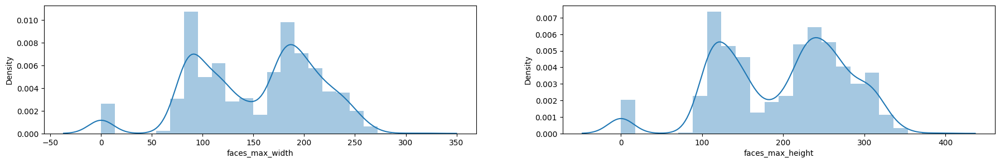

<ipython-input-72-d408373523ee>:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  d = sns.distplot(clean_faces_pd["faces_min_conf"], kde=True, ax=ax[0])
<ipython-input-72-d408373523ee>:9: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  d = sns.distplot(clean_faces_pd["faces_max_conf"], kde=True, ax=ax[1])


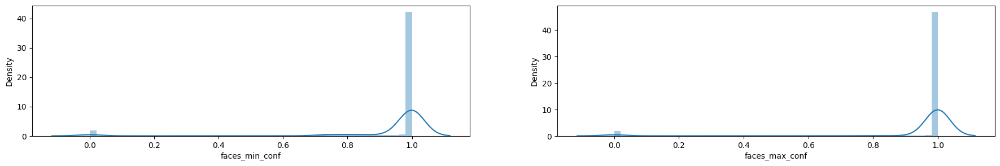

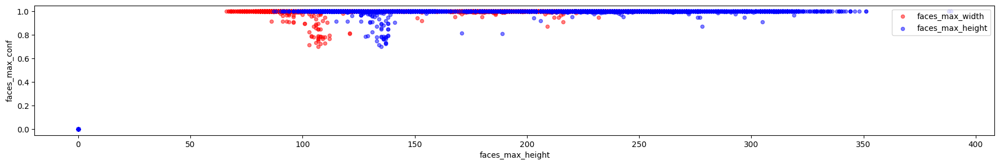

In [72]:
print("Faces stats:")
print(clean_faces_pd[["faces_max_width", "faces_max_height", "faces_min_conf", "faces_max_conf"]].describe(percentiles=[0.01,0.05, 0.1,0.25,0.5,0.75,0.9,0.95,0.99]))
fig, ax = plt.subplots(1, 2, figsize=(22, 3))
d = sns.distplot(clean_faces_pd["faces_max_width"], kde=True, ax=ax[0])
d = sns.distplot(clean_faces_pd["faces_max_height"], kde=True, ax=ax[1])
plt.show()
fig, ax = plt.subplots(1, 2, figsize=(22, 3))
d = sns.distplot(clean_faces_pd["faces_min_conf"], kde=True, ax=ax[0])
d = sns.distplot(clean_faces_pd["faces_max_conf"], kde=True, ax=ax[1])
fig, ax = plt.subplots(figsize=(22, 3))
d = clean_faces_pd.plot(kind="scatter", x="faces_max_width", y="faces_max_conf", c="red", ax=ax, label="faces_max_width", alpha=0.5)
d = clean_faces_pd.plot(kind="scatter", x="faces_max_height", y="faces_max_conf", c="blue", ax=d,  label="faces_max_height", alpha=0.5)
d = plt.legend(loc="upper right")

In [73]:
!pip install imutils

In [75]:
import os
import numpy as np
import shutil
import cv2
import pandas as pd
import matplotlib
matplotlib.use("Agg")
import matplotlib.pyplot as plt
import numpy as np
import pickle
from imutils import paths
from keras.preprocessing.image import ImageDataGenerator
from keras.applications import VGG16
from keras.layers import Dropout
from keras.layers import Flatten
from keras.layers import Dense
from keras.layers import Input
from keras.models import Model
from keras.optimizers import SGD
from sklearn.metrics import classification_report
%matplotlib inline

In [84]:
BASE_PATH = "/kaggle/working/finetuningkeras/dataset"

# define the names of the training, testing, and validation
# directories
TRAIN = "training"
TEST = "evaluation"
VAL = "validation"

REAL = 'REAL'
FAKE = 'FAKE'

# initialize the list of class label names
CLASSES = ["FAKE", "REAL"]


# set the batch size when fine-tuning
BATCH_SIZE = 32

trainEpochs = 10
epochsFineTune = 10
maxVids = 5

# set the path to the serialized model after training
MODEL_PATH = os.path.sep.join(["/kaggle/working/finetuningkeras","output", "Deepfake.model"])

# define the path to the output training history plots
UNFROZEN_PLOT_PATH = os.path.sep.join(["/kaggle/working/finetuningkeras","output", "unfrozen.png"])
WARMUP_PLOT_PATH = os.path.sep.join(["/kaggle/working/finetuningkeras","output", "warmup.png"])

file = '/content/drive/MyDrive/deepfake-detection-challenge/train_sample_videos/metadata.json'
img_path = '/content/drive/MyDrive/deepfake-detection-challenge/train_sample_videos'
data_path = '/kaggle/working/finetuningkeras/real_fake'
dir_fake_frames = '/kaggle/working/FAKE_frames'
dir_real_frames = '/kaggle/working/REAL_frames'
dir_output = '/kaggle/working/finetuningkeras/output'

dir_data_path_real = os.path.join(data_path, REAL)
dir_data_path_fake = os.path.join(data_path, FAKE)

dir_train_real = os.path.join(BASE_PATH, TRAIN, REAL)
dir_train_fake = os.path.join(BASE_PATH, TRAIN, FAKE)
dir_valid_real = os.path.join(BASE_PATH, VAL, REAL)
dir_valid_fake = os.path.join(BASE_PATH, VAL, FAKE)
dir_test_real = os.path.join(BASE_PATH, TEST, REAL)
dir_test_fake = os.path.join(BASE_PATH, TEST, FAKE)

In [77]:
input_dir = '/kaggle/working/finetuningkeras/real_fake/FAKE'
output_dir = '/kaggle/working/FAKE_frames/'
def explode_frames(input_dir, output_dir, maxN):

    mp4_filenames = [f for f in os.listdir(input_dir) if f.endswith('.mp4')]
    n = 0

    for mp4fn in mp4_filenames:

        if(n < maxN):
            n += 1
            mp4fp = os.path.join(input_dir, mp4fn)
            cam = cv2.VideoCapture(mp4fp)
            if(cam.isOpened()):
                print('Processing file #'+ str(n) + ' (' + mp4fn + ')...')
            else:
                print('Problem opening file #'+ str(n) + ' (' + mp4fn + ')...')
                continue

            nframe = 0
            while(True): #continue until ret = False then break
                nframe += 1
                ret,frame = cam.read()

                if ret:
                    # if video is still left continue creating images
                    out_filename = os.path.splitext(mp4fn)[0]+  '_frame' + str(nframe) + '.jpg'
                    out_filepath =  os.path.join(output_dir, out_filename)

                    # writing the extracted images
                    cv2.imwrite(out_filepath, frame)
                else:
                    break

            # Release all space and windows once done
            print(' - created ' + str(nframe-1) + ' images') # -1 bc count incremented before exit
            cam.release()
            cv2.destroyAllWindows()

        else:
            break

"""
Distribute files/images from a source directory into training, validation, and testing directories.
src_dir = source/input directory
train_dir, val_dir, test_dir = target training/validation/testing directory
valperc = fraction of dataset to use for validation (0-1)
testperc = fraction of dataset to use for testing (0-1)
"""

def trainvaltest_split(src_dir, train_dir, val_dir, test_dir, valperc = 0.15, testperc = 0.15):

    filenames = os.listdir(src_dir) #get all filenames in random order
    np.random.shuffle(filenames)

    n = len(filenames)
    split1 = int(n*(1 - (valperc + testperc)))
    split2 = int(n*(1 - (testperc)))

    fn_train, fn_val, fn_test = np.split(np.array(filenames), [split1, split2])

    fn_lists = [fn_train, fn_val, fn_test]
    targetdirs = [train_dir, val_dir, test_dir]

    print('Total images: ', n)
    print('Training: ', len(fn_train))
    print('Validation: ', len(fn_val))
    print('Testing: ', len(fn_test))

    all_fp = [os.path.join(src_dir, fn) for fn in filenames]

    #move files
    for i, fn_list in enumerate(fn_lists):
        for fn in fn_list:
            target_dir = targetdirs[i]
            fp_from = os.path.join(src_dir, fn)
            fp_to = os.path.join(target_dir, fn)

            shutil.move(fp_from, fp_to)


"""
Construct a plot that plots and saves the training history
"""
def plot_training(H, N, plotPath):
	plt.style.use("ggplot")
	plt.figure()
	plt.plot(np.arange(0, N), H.history["loss"], label="train_loss")
	plt.plot(np.arange(0, N), H.history["val_loss"], label="val_loss")
	plt.plot(np.arange(0, N), H.history["accuracy"], label="train_acc")
	plt.plot(np.arange(0, N), H.history["val_accuracy"], label="val_acc")
	plt.title("Training Loss and Accuracy")
	plt.xlabel("Epoch #")
	plt.ylabel("Loss/Accuracy")
	plt.legend(loc="lower left")
	plt.savefig(plotPath)

In [78]:
os.makedirs(dir_train_real, exist_ok = True)
os.makedirs(dir_train_fake, exist_ok = True)
os.makedirs(dir_valid_real, exist_ok = True)
os.makedirs(dir_valid_fake, exist_ok = True)
os.makedirs(dir_test_real, exist_ok = True)
os.makedirs(dir_test_fake, exist_ok = True)

os.makedirs(dir_data_path_real, exist_ok = True)
os.makedirs(dir_data_path_fake, exist_ok = True)
os.makedirs(dir_fake_frames, exist_ok = True)
os.makedirs(dir_real_frames, exist_ok = True)
os.makedirs(dir_output, exist_ok = True)

In [81]:
file = '/content/drive/MyDrive/deepfake-detection-challenge/train_sample_videos/metadata.json'

In [82]:
df = pd.read_json(file)
df = df.T

# %% [code]
label = df[['label']]

In [85]:
for fn, row in label.iterrows():
    src = os.path.join(img_path, fn)
    dest = os.path.join(data_path, row['label'], fn)
    shutil.copy(src, dest)

In [86]:
explode_frames(dir_data_path_fake, dir_fake_frames, maxN= maxVids)

Processing file #1 (aapnvogymq.mp4)...
 - created 300 images
Processing file #2 (bqnymlsayl.mp4)...
 - created 300 images
Processing file #3 (ebywfrmhtd.mp4)...
 - created 300 images
Processing file #4 (bbvgxeczei.mp4)...
 - created 300 images
Processing file #5 (brhalypwoo.mp4)...
 - created 300 images


In [87]:
explode_frames(dir_data_path_real, dir_real_frames, maxN= maxVids)

Processing file #1 (cfxkpiweqt.mp4)...
 - created 300 images
Processing file #2 (anpuvshzoo.mp4)...
 - created 300 images
Processing file #3 (abarnvbtwb.mp4)...
 - created 300 images
Processing file #4 (cppdvdejkc.mp4)...
 - created 298 images
Processing file #5 (dbtbbhakdv.mp4)...
 - created 300 images


In [88]:
trainvaltest_split(src_dir = dir_fake_frames,
                   train_dir = dir_train_fake,
                   val_dir = dir_valid_fake,
                   test_dir = dir_test_fake)

Total images:  1500
Training:  1050
Validation:  225
Testing:  225


In [89]:
trainvaltest_split(src_dir = dir_real_frames,
                   train_dir = dir_train_real,
                   val_dir = dir_valid_real,
                   test_dir = dir_test_real)

Total images:  1498
Training:  1048
Validation:  225
Testing:  225


In [90]:
trainAug = ImageDataGenerator(
	rotation_range=30,
	zoom_range=0.15,
	width_shift_range=0.2,
	height_shift_range=0.2,
	shear_range=0.15,
	horizontal_flip=True,
	fill_mode="nearest")

In [91]:
valAug = ImageDataGenerator()

In [92]:
mean = np.array([123.68, 116.779, 103.939], dtype="float32")
trainAug.mean = mean
valAug.mean = mean

In [93]:
trainPath = os.path.join(BASE_PATH, TRAIN)
trainGen = trainAug.flow_from_directory(
	trainPath,
	class_mode="categorical",
	target_size=(224, 224),
	color_mode="rgb",
	shuffle=True,
	batch_size=BATCH_SIZE)

# initialize the validation generator
valPath = os.path.join(BASE_PATH, VAL)
valGen = valAug.flow_from_directory(
	valPath,
	class_mode="categorical",
	target_size=(224, 224),
	color_mode="rgb",
	shuffle=False,
	batch_size=BATCH_SIZE)

# initialize the testing generator
testPath = os.path.join(BASE_PATH, TEST)
testGen = valAug.flow_from_directory(
	testPath,
	class_mode="categorical",
	target_size=(224, 224),
	color_mode="rgb",
	shuffle=False,
	batch_size=BATCH_SIZE)

Found 2098 images belonging to 2 classes.
Found 450 images belonging to 2 classes.
Found 450 images belonging to 2 classes.


In [94]:
baseModel = VGG16(weights="imagenet", include_top=False,
	input_tensor=Input(shape=(224, 224, 3)))

58889256/58889256 [==============================] - 3s 0us/step


In [96]:
headModel = baseModel.output
headModel = Flatten(name="flatten")(headModel)
headModel = Dense(512, activation="relu")(headModel)
headModel = Dropout(0.5)(headModel)
headModel = Dense(len(CLASSES), activation="softmax")(headModel)

In [97]:
model = Model(inputs=baseModel.input, outputs=headModel)

In [98]:
for layer in baseModel.layers:
	layer.trainable = False

In [99]:
print("[INFO] compiling model...")
opt = SGD(lr=1e-4, momentum=0.9)
model.compile(loss="categorical_crossentropy", optimizer=opt,
	metrics=["accuracy"])

[INFO] compiling model...


In [ ]:
totalTrain = len(list(paths.list_images(trainPath)))
totalVal = len(list(paths.list_images(valPath)))
totalTest = len(list(paths.list_images(testPath)))

print("[INFO] training head...")
H = model.fit(
    trainGen,
    steps_per_epoch=totalTrain // BATCH_SIZE,
    validation_data=valGen,
    validation_steps=totalVal // BATCH_SIZE,
    epochs=trainEpochs)

In [101]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn import svm

In [110]:
!pip install chardet

In [111]:
import chardet
with open('/content/spam.csv', 'rb') as f:
    encoding = chardet.detect(f.read())['encoding']

In [113]:
dataset = pd.read_csv('/content/spam.csv', encoding=encoding)

In [114]:
dataset.head()

,v1,v2,Unnamed: 2,Unnamed: 3,Unnamed: 4
0,ham,"Go until jurong point, crazy.. Available only ...",NaN,NaN,NaN
1,ham,Ok lar... Joking wif u oni...,NaN,NaN,NaN
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...,NaN,NaN,NaN
3,ham,U dun say so early hor... U c already then say...,NaN,NaN,NaN
4,ham,"Nah I don't think he goes to usf, he lives aro...",NaN,NaN,NaN


In [116]:
import pandas as pd

dataset = dataset.rename(columns={'v1': 'label', 'v2': 'content'})


dataset = dataset.loc[:, ~df.columns.str.contains('^Unnamed')]

# Now df contains the updated column names and dropped unnamed columns
print(dataset)


IndexError: Boolean index has wrong length: 3 instead of 5

In [ ]:
print("[INFO] evaluating after fine-tuning network head...")
testGen.reset()
predIdxs = model.predict_generator(testGen,
	steps=(totalTest // BATCH_SIZE) + 1)
predIdxs = np.argmax(predIdxs, axis=1)
print(classification_report(testGen.classes, predIdxs,
	target_names=testGen.class_indices.keys()))


plot_training(H, trainEpochs, WARMUP_PLOT_PATH)
plt.show()

In [ ]:
from keras.utils import plot_model
plot_model(model, to_file='model.png')

In [ ]:
from sklearn.metrics import roc_curve, auc, confusion_matrix, classification_report
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [ ]:
# Assuming testGen and model are defined
testGen.reset()
y_pred_probs = model.predict(testGen, steps=(totalTest // BATCH_SIZE) + 1)
y_true = testGen.classes

# Compute ROC curve for the positive class
fpr, tpr, _ = roc_curve(y_true, y_pred_probs[:, 1])
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=1, label='ROC curve (area = %0.2f)' % roc_auc)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

In [ ]:
testGen.reset()
y_pred_probs = model.predict(testGen, steps=(totalTest // BATCH_SIZE) + 1)

In [ ]:
# Compute predicted class labels
y_pred_labels = np.argmax(y_pred_probs, axis=1)

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred_labels)

# Plot confusion matrix
plt.figure(figsize=(5,5))
sns.heatmap(cm, annot=True, fmt="d")
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

In [ ]:
def plot_epoch_vs_accuracy(H, save_path=None):
    print("Starting to plot...")  # Debugging print statement
    epochs = len(H.history['accuracy'])  # Automatically determine the number of epochs
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, epochs + 1), H.history['accuracy'], label='Train Accuracy')
    plt.plot(range(1, epochs + 1), H.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Epoch vs Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()

    if save_path:
        plt.savefig(save_path)

    plt.show()
    print("Plot should be displayed above.")  # Debugging print statement

# Assuming H is defined in your existing code
plot_epoch_vs_accuracy(H)